# K_means to obtain directions in the latent space
- Model: WineLabels - if not present, the code will return error
- GAN: Stylegan2

### SETUP

In [4]:
import os
import sys
sys.path.append('stylegan2/')
import torch
import numpy as np
from sklearn import svm
import dnnlib
import legacy
from PIL import Image


# Load the pre-trained model
network_pkl = './stylegan2/Models/wine-network.pkl'
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')

if torch.cuda.is_available():
    print("CUDA is available. Using GPU.")
else:
    print("CUDA is not available. Using CPU. (this will be significantly slower)")

# Load the model
with open(network_pkl, 'rb') as f:
    G = legacy.load_network_pkl(f)['G_ema'].to(device)  # Assuming 'G_ema' is the generator

CUDA is available. Using GPU.


/home/juan/git/ControlledGeneration/ganvenv/lib/python3.10/site-packages/torch/storage.py:414: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  return torch.load(io.BytesIO(b))

### WARNING MANAGEMENT

When used, the generator will show the following errors:
>UserWarning: Failed to build CUDA kernels for upfirdn2d. Falling back to slow reference implementation. Details:
Traceback (most recent call last):
  File "/home/juan/git/ControlledGeneration/stylegan2/torch_utils/ops/upfirdn2d.py", line 32, in _init
    _plugin = custom_ops.get_plugin('upfirdn2d_plugin', sources=sources, extra_cuda_cflags=['--use_fast_math'])
              ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/home/juan/git/ControlledGeneration/stylegan2/torch_utils/custom_ops.py", line 110, in get_plugin
    torch.utils.cpp_extension.load(name=module_name, verbose=verbose_build, sources=sources, **build_kwargs)
  File "/home/juan/git/ControlledGeneration/.venv/lib/python3.12/site-packages/torch/utils/cpp_extension.py", line 1312, in load
    return _jit_compile(
           ^^^^^^^^^^^^^
  File "/home/juan/git/ControlledGeneration/.venv/lib/python3.12/site-packages/torch/utils/cpp_extension.py", line 1747, in _jit_compile
    return _import_module_from_library(name, build_directory, is_python_module)
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/home/juan/git/ControlledGeneration/.venv/lib/python3.12/site-packages/torch/utils/cpp_extension.py", line 2141, in _import_module_from_library
    module = importlib.util.module_from_spec(spec)
             ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "<frozen importlib._bootstrap>", line 813, in module_from_spec
  File "<frozen importlib._bootstrap_external>", line 1289, in create_module
  File "<frozen importlib._bootstrap>", line 488, in _call_with_frames_removed
ImportError: /home/juan/.cache/torch_extensions/py312_cu118/upfirdn2d_plugin/upfirdn2d_plugin.so: cannot open shared object file: No such file or directory


This error occurs for 2 reasons: 
 - C++ Compiler and libraries are not setup. To fix install all necessary dependencies.
 - Cuda version is not  10.1 (only for ubuntu 18.04)
To fix use an ubuntu 18.04 env with the dated [cuda 10.1](https://developer.nvidia.com/cuda-10.1-download-archive-base?target_os=Linux&target_arch=x86_64&target_distro=Ubuntu&target_version=1810). It is possible that any version of cudatoolkit that works with Torch 1.x will work but this will require at most ubuntu 20.04

If done correctly this line of code must run without errors:
> python -c "import torch; import upfirdn2d_op; import fused; print('OK')"

Otherwise, run the next block to suppress error messages:

In [5]:
""" ===================== Warning/Error supressor ======================= 
By default, StyleGAN2 prints a lot of warnings and errors to the console.
This code block suppresses them. If you want to see the warnings/errors,
comment out the code block below.

However, be cautious when using this approach. Silencing error messages 
can make it difficult to debug issues in your code, as you won't see any 
error output. Use it only when you are certain that you do not need to see 
any error messages, redirect sys.stderr temporarily and restore 
it later.
========================================================================="""
import warnings
# Suppress specific warnings
warnings.filterwarnings("ignore", message="Failed to build CUDA kernels for bias_act")
warnings.filterwarnings("ignore", message="Failed to build CUDA kernels for upfirdn2d")
# Redirect stderr to suppress error messages
sys.stderr = open(os.devnull, 'w')

In [6]:
"""======================= Restoring Errors ==========================================
Uncomment and run this line to restore stderr to display errors/warnings in the console.
======================================================================================="""
#sys.stderr = sys.__stderr__

'======================= Restoring Errors ==========================================\nUncomment and run this line to restore stderr to display errors/warnings in the console.\n======================================================================================='

# Image Pool Generation
To get the best quality k-means model a datapool with x number of images is generated <br>
More images will provide a better result.

In [7]:
"======================================EDIT====================================="
# Specify the number of images to generate
X_NUM_OF_IMAGES = 1000
# Specify the folder where images will be saved
save_folder = './wine/generated_seeds'
latent_folder = './wine/latent_vectors_from_seeds'
"==============================================================================="
os.makedirs(save_folder, exist_ok=True)  # Create the folder if it doesn't exist
os.makedirs(latent_folder, exist_ok=True)  # Create the folder if it doesn't exist

# Initialize images as an empty list
images = []
#Generate all the seeds from range 0->(X-1)
seeds = [i for i in range(X_NUM_OF_IMAGES)]
# Ensure the model is on the correct device
G.to(device)

# We use the Generator to create images, remember that errors could be turned off
def generate_image(G, seed=0):
    torch.manual_seed(seed) # Seed RNG for this iteration
    z = torch.randn(1, 512).to(device) # Generate random z vector 
    # If preloaded model suppors classes:
    #   img = G(z, torch.zeros([1, G.c_dim]).to(device), truncation_psi=0.5, noise_mode='const')
    img = G(z, None, truncation_psi=0.5, noise_mode='const') # Generate image
    img = (img.permute(0, 2, 3, 1) * 127.5 + 128).clamp(0, 255).to(torch.uint8) # Convert image to 0-255 range
    img_pil = Image.fromarray(img[0].cpu().numpy(), 'RGB') # Convert image to PIL image
    img_pil.save(os.path.join(save_folder, f'image_{seed}.png')) # Save image
    np.save(f'{latent_folder}/seed_{seed}.npy', z.cpu().numpy()) # Save latent vector
    return img_pil

# Generate and save images and latent vectors for each seed
images = [generate_image(G, seed) for seed in seeds]

# Saving results in an numpy array
images = np.array(images)


Setting up PyTorch plugin "bias_act_plugin"... Done.
Setting up PyTorch plugin "upfirdn2d_plugin"... Done.


### Using K-means to search for groupings

K-means is used as an unsupervised method to search for groupings of vectors that could edit specific characteristics.<br>
Change the N number of clusters to maximize number of controllable characteristics vs quality of direction vectors.

In [8]:
"======================================EDIT====================================="
dir_folder = 'wine/direction_vectors'
N_CLUSTERS = 300
latent_folder = './wine/latent_vectors_from_seeds'
"==============================================================================="
os.makedirs(dir_folder, exist_ok=True) # Create the folder if it doesn't exist
# Check if latent vectors folder exists (just in case)
if not os.path.exists(latent_folder):
    raise FileNotFoundError(f"The folder '{latent_folder}' does not exist.")

from sklearn.cluster import KMeans
# The vectors generated in the previous step are loaded
def load_vectors_from_folder(latent_folder):
    # List all files in the folder
    filenames = [f for f in os.listdir(latent_folder) if f.endswith('.npy')]
    
    # Sort filenames by extracting the numeric part
    filenames.sort(key=lambda x: int(x.split('_')[1].split('.')[0]))

    # Load each vector and append it to a list
    vectors = []
    for filename in filenames:
        file_path = os.path.join(latent_folder, filename)
        vector = np.load(file_path)
        vectors.append(vector.flatten())  # Flatten each vector
    return np.array(vectors)

# Load the vectors
latent_vectors = load_vectors_from_folder(latent_folder)
print(latent_vectors.shape)  # Print the shape of the vectors

# Fit the KMeans model\
try:
    kmeans = KMeans(n_clusters=N_CLUSTERS, random_state=0, n_init="auto").fit(latent_vectors)
    labels = kmeans.labels_
    # Save the direction vectors
    for i, avg_vector in enumerate(kmeans.cluster_centers_):
        np.save(f'{dir_folder}/vector_{i}.npy', avg_vector)
    print("Direction vectors saved successfully.")
except Exception as e:
    print(f"An error occurred during KMeans fitting: {e}")
    raise

# Graph the amount of images per cluster
import matplotlib.pyplot as plt
from collections import Counter
# Count the number of images in each cluster
cluster_counts = Counter(labels)
# Sort the clusters by count
sorted_clusters = sorted(cluster_counts.items(), key=lambda x: x[0])
# Extract the counts
counts = [count for cluster, count in sorted_clusters]
# Plot the counts
plt.plot(counts)
plt.xlabel("Cluster")
plt.ylabel("Number of images")
plt.title("Number of images per cluster")
plt.show()

(1000, 512)
Direction vectors saved successfully.


### Graphing the results
- A specified seed is used as an starting point
- Each direction vector impact is showcased

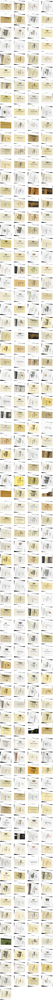

In [9]:
"======================================EDIT====================================="
STRENGTH = 3
START_SEED = 4
"==============================================================================="

import matplotlib.pyplot as plt
def generate_image_from_w(G, w):
    img = G(w, None, truncation_psi=0.5, noise_mode='const')
    img = (img.permute(0, 2, 3, 1) * 127.5 + 128).clamp(0, 255).to(torch.uint8)
    return Image.fromarray(img[0].cpu().numpy(), 'RGB')

def plot_images(images, num_columns=4):
    num_images = len(images)
    num_rows = (num_images + num_columns - 1) // num_columns
    fig, axes = plt.subplots(num_rows, num_columns, figsize=(num_columns * 5, num_rows * 5))
    
    for i, img in enumerate(images):
        ax = axes[i // num_columns, i % num_columns]
        ax.imshow(img)
        ax.axis('off')
        txt = f"Vector {i-1}" if i > 0 else "Original"
        ax.title.set_text(txt)
    
    # Turn off axes for any unused subplots
    for j in range(i + 1, num_rows * num_columns):
        axes[j // num_columns, j % num_columns].axis('off')
    plt.show()

# Assuming cluster_averages, G, and z are defined
images = []
torch.manual_seed(START_SEED)
z = torch.randn(1, 512).to(device)
original = generate_image_from_w(G,z)
images.append(original)

for i, avg_vector in enumerate(kmeans.cluster_centers_):
    dir_vector = torch.tensor(avg_vector).to(device)
    new_z = z.clone()
    new_z += dir_vector * STRENGTH
    img = generate_image_from_w(G, new_z)
    images.append(img)

# Plot all images in a grid
plot_images(images, num_columns=4)  # Adjust num_columns as needed